# Import Package

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights

# Configuration

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.set_default_device(device)

imsize = 512

style_path = './data/images/style/Orangery At Versailles.jpg'
content_path = './data/images/content/S__73826352_0.jpg'

# Basic / Intermediate Level
content_layer_default = ['conv_3', 'conv_4']
style_layer_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5', 'conv_6', 'conv_7', 'conv_8']

# Advanced Level
advanced_style_layer_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5', 'conv_6', 'conv_7', 'conv_8', 'conv_9', 'conv_10']

num_run = 1500
style_weight = 10000
content_weight = 1

# Oringal Image

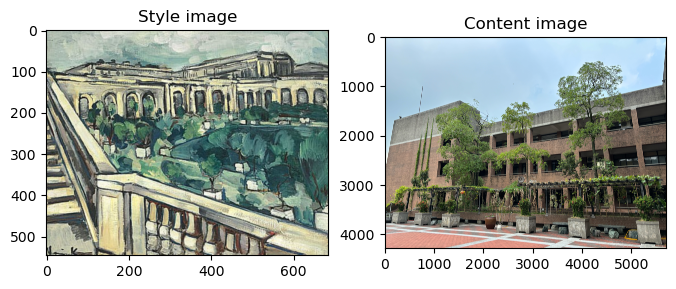

In [ ]:
style_img=Image.open(style_path)
content_img=Image.open(content_path)

plt.figure(figsize=(8,6))
plt.subplot(1,2,1)
%matplotlib inline
plt.imshow(style_img)
#plt.axis('off')
plt.title('Style image')

plt.subplot(1,2,2)
%matplotlib inline
plt.imshow(content_img)
#plt.axis('off')
plt.title('Content image')
plt.show()

# Loss Function

In [ ]:
loader = transforms.Compose([transforms.Resize([imsize, imsize]), transforms.ToTensor()])

def image_loader(img_path):
    img = Image.open(img_path)
    img = loader(img).unsqueeze(0)
    return img

# 將張量轉為 PIL 圖像
unloader = transforms.ToPILImage()

# Gram Matrix
def gram_matrix(input):
    a, b, c, d = input.size()
    features = input.view(a * b, c * d)
    G = torch.mm(features, features.t())
    return G.div(a * b * c * d)

# Content Loss
class Contentloss(nn.Module):
    def __init__(self, target):
        super().__init__()
        self.target = target.detach()
        self.loss_fn = nn.MSELoss()

    def forward(self, input):
        self.loss = self.loss_fn(input, self.target)
        return input

# Style Loss
class Styleloss(nn.Module):
    def __init__(self, target_feature):
        super().__init__()
        self.target = gram_matrix(target_feature).detach()
        self.loss_fn = nn.MSELoss()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = self.loss_fn(self.target, G)
        return input

# Normalization

In [ ]:
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406])
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225])

class Normalization(nn.Module):
    def __init__(self, mean, std):
        super().__init__()
        self.mean = mean.view(-1, 1, 1)
        self.std = std.view(-1, 1, 1)

    def forward(self, input):
        return (input - self.mean) / self.std

normalize = Normalization(cnn_normalization_mean, cnn_normalization_std)

# Import Model

In [ ]:
cnn = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()

# Getting and Adding Layers from VGG19

In [ ]:
# 獲取特徵層
def get_layer_and_add_loss(cnn, model, content_img, style_img, content_layer, style_layer):
    i = 0
    content_losses = []
    style_losses = []

    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = f'conv_{i}'
        elif isinstance(layer, nn.ReLU):
            name = f'relu_{i}'
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = f'pool_{i}'
        elif isinstance(layer, nn.BatchNorm2d):
            name = f'bn_{i}'
        else:
            raise RuntimeError(f'Unrecognized layer: {layer.__class__.__name__}')

        model.add_module(name, layer)

        if name in content_layer:
            target = model(content_img).detach()
            contentloss = Contentloss(target)
            model.add_module(f'content_loss_{i}', contentloss)
            content_losses.append(contentloss)

        if name in style_layer:
            target_feature = model(style_img).detach()
            styleloss = Styleloss(target_feature)
            model.add_module(f'style_loss_{i}', styleloss)
            style_losses.append(styleloss)

    for i in range(len(model)-1, -1, -1):
        if isinstance(model[i], Contentloss) or isinstance(model[i], Styleloss):
            break
    model=model[:(i+1)].to(device)

    return model, content_losses, style_losses

# Optimizer

In [ ]:
def optimizer_input_img(input_img):
    return optim.LBFGS([input_img])

# Input Image (+ White Noise)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-4.858007..5.01943].


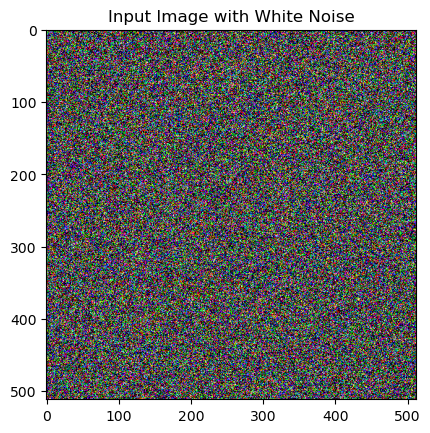

In [ ]:
input_img = torch.randn(image_loader(content_path).size()).to(device, torch.float)
unloader = transforms.ToPILImage()
plt.figure()
# plt.axis('off')
plt.title('Input Image with White Noise')
input_medium = input_img.squeeze(0).cpu().detach()
plt.imshow(input_medium.permute(1, 2, 0))
plt.show()

# Generation Loop

In [ ]:
def run_model(cnn, model, content_img, style_img, content_layer, style_layer, input_img, num_run, content_weight, style_weight, output_name):
    print(f"Building neural transfer model for {output_name}...")
    model, content_losses, style_losses = get_layer_and_add_loss(cnn, model, content_img, style_img, content_layer, style_layer)

    input_img.requires_grad_(True)
    model.eval()
    model.requires_grad_(False)

    optimizer = optimizer_input_img(input_img)
    print("Optimizing...")

    run = [0]
    intermediate_results = []

    while run[0] <= num_run:
        def closure():
            with torch.no_grad():
                input_img.clamp_(0, 1)

            optimizer.zero_grad()
            model(input_img)
            content_score = 0
            style_score = 0

            for cl in content_losses:
                content_score += cl.loss
            for sl in style_losses:
                style_score += sl.loss

            content_score *= content_weight
            style_score *= style_weight
            loss = content_score + style_score

            loss.backward()
            run[0] += 1

            # 每 50 次迭代秀出當前 loss
            if run[0] % 50 == 0:
                print(f"run {run[0]}: Content Loss: {content_score.item()}, Style Loss: {style_score.item()}")

            # 每 100 次迭代保存圖像结果
            if run[0] % 100 == 0:
                intermediate_image = unloader(input_img.squeeze(0).cpu().detach())
                intermediate_results.append(intermediate_image)

            return loss

        optimizer.step(closure)

    with torch.no_grad():
        input_img.clamp_(0, 1)

    final_image = unloader(input_img.squeeze(0).cpu())
    final_image.save(output_name)
    print(f"\nSaved result as {output_name}")

    return input_img, intermediate_results

# Image Generation (Basic Level)

In [ ]:
# 正向風格轉換
output_img, basic_results = run_model(
    cnn,
    nn.Sequential(normalize),
    image_loader(content_path).to(device, torch.float),
    image_loader(style_path).to(device, torch.float),
    content_layer_default,
    style_layer_default,
    input_img,
    num_run,
    content_weight,
    style_weight,
    './basic_level.jpg'
)

Building neural transfer model for ./basic_level.jpg...
Optimizing...
run 50: Content Loss: 45.33294677734375, Style Loss: 13.695938110351562
run 100: Content Loss: 26.692432403564453, Style Loss: 5.543406963348389
run 150: Content Loss: 17.517335891723633, Style Loss: 3.5975863933563232
run 200: Content Loss: 12.72587776184082, Style Loss: 2.868368148803711
run 250: Content Loss: 10.281816482543945, Style Loss: 2.4013421535491943
run 300: Content Loss: 8.98554515838623, Style Loss: 2.133100748062134
run 350: Content Loss: 8.292461395263672, Style Loss: 1.968754768371582
run 400: Content Loss: 7.921762466430664, Style Loss: 1.8649249076843262
run 450: Content Loss: 7.632627487182617, Style Loss: 1.7958320379257202
run 500: Content Loss: 7.654253959655762, Style Loss: 1.7743148803710938
run 550: Content Loss: 7.450414657592773, Style Loss: 1.6940442323684692
run 600: Content Loss: 7.445955276489258, Style Loss: 1.650907039642334
run 650: Content Loss: 14.484529495239258, Style Loss: 44.

# Show Fusion Results (Basic Level)

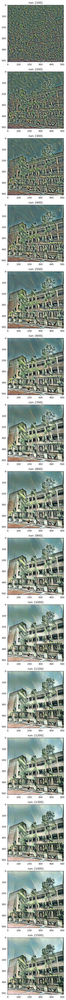

In [ ]:
def show_images(intermediate_results, step=100):
    num_images = len(intermediate_results)

    # 創建列數等於圖片數的子圖
    fig, axes = plt.subplots(num_images, 1, figsize=(8, num_images * 4))  # 每行展示一張圖片，調整高度以適應圖像
    if num_images == 1:
        axes = [axes]  # 如果只有一张图片，确保 axes 是列表

    # 遍歷中間结果並顯示
    for idx, img in enumerate(intermediate_results):
        axes[idx].imshow(img)
        # axes[idx].axis('off')
        axes[idx].set_title(f"run: {[step * (idx + 1)]}", fontsize=12)

    plt.tight_layout()
    plt.show()

show_images(basic_results, step=100)

# Image Generation (Advanced Level)

In [ ]:
# 正向風格轉換
output_img, advanced_results = run_model(
    cnn,
    nn.Sequential(normalize),
    image_loader(content_path).to(device, torch.float),
    image_loader(style_path).to(device, torch.float),
    content_layer_default,
    advanced_style_layer_default,
    input_img,
    num_run,
    content_weight,
    style_weight,
    './advanced_level.jpg'
)

Building neural transfer model for ./advanced_level.jpg...
Optimizing...
run 50: Content Loss: 8.173921585083008, Style Loss: 2.2639331817626953
run 100: Content Loss: 7.620173454284668, Style Loss: 2.053807258605957
run 150: Content Loss: 7.440893173217773, Style Loss: 1.9634153842926025
run 200: Content Loss: 7.336407661437988, Style Loss: 1.9235568046569824
run 250: Content Loss: 7.298223972320557, Style Loss: 1.876051664352417
run 300: Content Loss: 7.257183074951172, Style Loss: 1.8422179222106934
run 350: Content Loss: 7.44819450378418, Style Loss: 1.9696353673934937
run 400: Content Loss: 7.402425765991211, Style Loss: 2.736196279525757
run 450: Content Loss: 7.30775260925293, Style Loss: 1.8591105937957764
run 500: Content Loss: 41.805023193359375, Style Loss: 39.18865203857422
run 550: Content Loss: 21.40163803100586, Style Loss: 5.966437816619873
run 600: Content Loss: 14.017982482910156, Style Loss: 3.3407647609710693
run 650: Content Loss: 11.10845947265625, Style Loss: 2.5

# Show Fusion Results (Advanced Level)

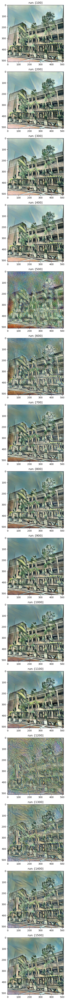

In [ ]:
show_images(advanced_results, step=100)

# The Effect of the Number of Layers

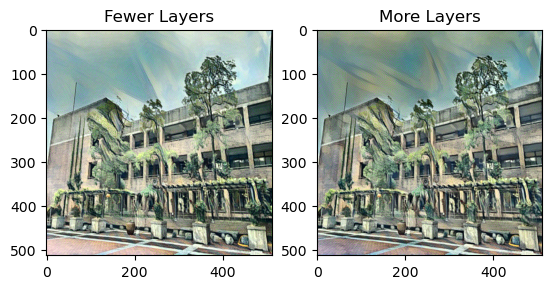

In [ ]:
# Advanced Level
plt.figure()
plt.subplot(1, 2, 1)
%matplotlib inline
plt.imshow(basic_results[-1])
plt.title('Fewer Layers')

plt.subplot(1, 2, 2)
%matplotlib inline
plt.imshow(advanced_results[-1])
plt.title('More Layers')
plt.show()

# Original & Forward Operation Image

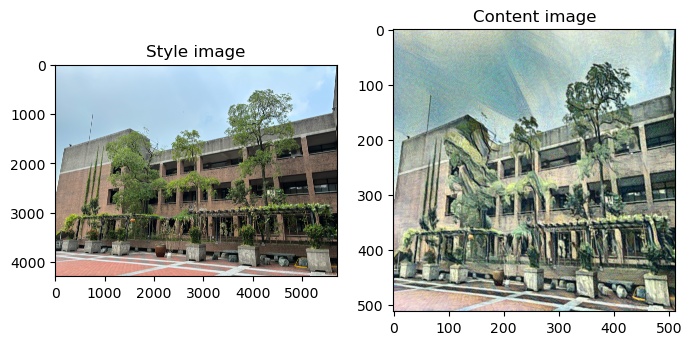

In [ ]:
style_path, content_path = './data/images/content/S__73826352_0.jpg', './basic_level.jpg'

style_img=Image.open(style_path)
content_img=Image.open(content_path)

plt.figure(figsize=(8,6))
plt.subplot(1,2,1)
%matplotlib inline
plt.imshow(style_img)
#plt.axis('off')
plt.title('Style image')

plt.subplot(1,2,2)
%matplotlib inline
plt.imshow(content_img)
#plt.axis('off')
plt.title('Content image')
plt.show()

# Input Image

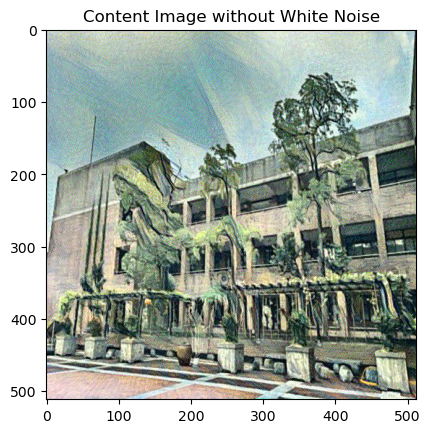

In [ ]:
# 不加 white noises 的效果比較好
input_img = image_loader(content_path).to(device, torch.float)
# input_img = torch.randn(image_loader(content_path).size()).to(device, torch.float)

unloader = transforms.ToPILImage()
plt.figure()
# plt.axis('off')
plt.title('Content Image without White Noise')
input_medium = input_img.squeeze(0).cpu().detach()
plt.imshow(input_medium.permute(1, 2, 0))
plt.show()

# Image Generation (Intermediate Level)

In [ ]:
# 逆向風格轉换
output_img, intermediate_results = run_model(
    cnn,
    nn.Sequential(normalize),
    image_loader(content_path).to(device, torch.float),
    image_loader(style_path).to(device, torch.float),
    content_layer_default,
    style_layer_default,
    input_img,
    num_run,
    content_weight,
    style_weight,
    './Intermediate_level.jpg'
)

Building neural transfer model for ./Intermediate_level.jpg...
Optimizing...
run 50: Content Loss: 14.265610694885254, Style Loss: 4.894077301025391
run 100: Content Loss: 13.273213386535645, Style Loss: 3.211665391921997
run 150: Content Loss: 13.001117706298828, Style Loss: 2.8415884971618652
run 200: Content Loss: 12.866495132446289, Style Loss: 2.6514410972595215
run 250: Content Loss: 12.771866798400879, Style Loss: 2.5006113052368164
run 300: Content Loss: 12.707748413085938, Style Loss: 2.41194486618042
run 350: Content Loss: 12.660770416259766, Style Loss: 2.3620903491973877
run 400: Content Loss: 12.618085861206055, Style Loss: 2.3293581008911133
run 450: Content Loss: 12.582361221313477, Style Loss: 2.2986397743225098
run 500: Content Loss: 12.55176830291748, Style Loss: 2.263449192047119
run 550: Content Loss: 12.523245811462402, Style Loss: 2.2338545322418213
run 600: Content Loss: 12.503292083740234, Style Loss: 2.2048227787017822
run 650: Content Loss: 12.484695434570312,

# Show Inverse Operation Results (Intermediate Level)

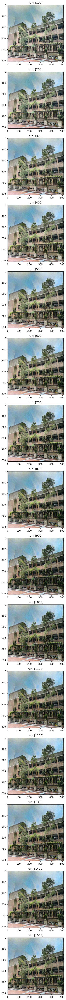

In [ ]:
show_images(intermediate_results, step=100)